# STV Application - Analyzing TalkingData Mobile User Demographics

## Table of contents
* [Introduction: A brief about the presented work](#introduction)
* [Data: Loading datasets and data wrangling](#data)
* [Analysis: Answering the questions in the Application](#analysis)

## Section 1: Introduction - A brief about what will be achieved in this Notebook <a name="introduction"></a>

This notebook will be tackling the analysis related questions in the application. The notebook is brokendown into multiple sections that will showcase the methodologies and techniques used, as well as a detailed explanation of the code. To achieve this, the reader will go through the following sections:

   * **Data**
   
   This section is dedicated to list the data sources that will be used in conducting the analysis. It will cover how and why each of the data sources is going to be helpful in the analysis part, the elements in each data source and how they relate to each other.  

   * **Analysis: Answering the questions in the Application**
   
   This section attempts to answer the three questions asked in the application, they are:
 
 
   **Part 1: Try to answer one or all of these questions (optional)**
   
       
   1. Compare the virality of different apps, and how does that relate to geographies 
   2. Are you able to predict growth for an app based on virality?
    
    
   **Part 2:** 
   
   3. Provide the business insights you find most compelling in this dataset. These can be for a fund, for an app owner, or any other party you choose. We expect you to analyze the dataset, extract some key insights, and visually present those to a business leader in the organiz-ation.
       
   *The reader will be presented with the techniques used in answering each of those questions, the algorithms and the rationale behind using them as well as a commentary on each section with recommendations pertaining to each question.*  

## Section 2: Loading datasets and data wrangling <a name="data"></a>

The datasets that will be analyzed are provided by (TalkingData Mobile User Demographics) on Kaggle, they include the following :

* **events.csv / app_events.csv** when a user uses TalkingData SDK, the event gets logged in this dataset. Each event has an event id, location (lat/long), and the event corresponds to a list of apps in app_events.
* **app_labels.csv** apps and their labels, the label_id's can be used to join with label_categories
* **label_categories.csv** apps' labels and their categories in text
* **gender_age_train.csv** provides the gender of each user matched with the device_id

The datasets will be joined together to form a one **Master Dataframe** on which the analysis will be conducted. The resulting dataframe will help in answering the questions asked in the application, namely, comparing the virality of different apps and their relation to geographies, predicting growth based on virality and finaly, providing a business insight for a fund, an app owner and or any other related party.

The **Master DataFrame** that will be used for the analysis will have the following columns:

* **Event_Id**: Corresponds to unique events initiated by a device
* **Device_Id**: Corresponds to the device through which an event is initiated
* **Timestamp**: Corresponds to the time when an event is initiated
* **Latitude and Longitude**: Coordinates of the initated event
* **App_Id**: Unique application id through which an event is initiated
* **is_installed**: Type of event that took place (the application was installed)
* **is_active**: Type of event that took place (the application was used)
* **Label_Id**: Label ids for the category under which each applications fall
* **Category**: Names of the categories under which the applications fall
* **Gender**: Gender of the users who initaite the events
* **Age**: Age of the users who initaite the events
* **Group**: Pre-defined age groups concatenated with gender

## Loading the necessary libraries and data wrangling

The following pieces of code will handle loading the datasets and data wrangling. This will ultimately yield the **Master DataFrame** that we will be working with for the analysis.

In [1]:
# Importing the needed libraries
import itertools
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import numpy as np
import matplotlib.ticker as ticker
from sklearn import preprocessing
import seaborn as sns
import types
from botocore.client import Config
import ibm_boto3
import matplotlib.cm as cm
import matplotlib.colors as colors
%matplotlib inline
sns.set(rc={'figure.figsize':(11.7,8.27)})

In [2]:
!pip install folium==0.11.0
import folium # map rendering library

     |████████████████████████████████| 102kB 7.9MB/s ta 0:00:011


### 1. Defining a function to load the datasets + Loading the datasets

In [3]:
# The code was removed by Watson Studio for sharing.

In [4]:
body = client_04a83e44ce06444787aad7f305b35388.get_object(Bucket='stvapplication-donotdelete-pr-h1tjgdo1oideg4',Key='app_events.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )
app_events = pd.read_csv(body)
app_events.head()

,event_id,app_id,is_installed,is_active
0,2,5927333115845830913,1,1
1,2,-5720078949152207372,1,0
2,2,-1633887856876571208,1,0
3,2,-653184325010919369,1,1
4,2,8693964245073640147,1,1


In [5]:
body = client_04a83e44ce06444787aad7f305b35388.get_object(Bucket='stvapplication-donotdelete-pr-h1tjgdo1oideg4',Key='events.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

events = pd.read_csv(body)
events.head()

,event_id,device_id,timestamp,longitude,latitude
0,1,29182687948017175,2016-05-01 00:55:25,121.38,31.24
1,2,-6401643145415154744,2016-05-01 00:54:12,103.65,30.97
2,3,-4833982096941402721,2016-05-01 00:08:05,106.60,29.70
3,4,-6815121365017318426,2016-05-01 00:06:40,104.27,23.28
4,5,-5373797595892518570,2016-05-01 00:07:18,115.88,28.66


In [6]:
body = client_04a83e44ce06444787aad7f305b35388.get_object(Bucket='stvapplication-donotdelete-pr-h1tjgdo1oideg4',Key='label_categories.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )
label_categories = pd.read_csv(body)
label_categories.head()

,label_id,category
0,1,NaN
1,2,game-game type
2,3,game-Game themes
3,4,game-Art Style
4,5,game-Leisure time


In [7]:
body = client_04a83e44ce06444787aad7f305b35388.get_object(Bucket='stvapplication-donotdelete-pr-h1tjgdo1oideg4',Key='app_labels.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )
app_labels = pd.read_csv(body)
app_labels.head()

,app_id,label_id
0,7324884708820027918,251
1,-4494216993218550286,251
2,6058196446775239644,406
3,6058196446775239644,407
4,8694625920731541625,406


In [8]:
body = client_04a83e44ce06444787aad7f305b35388.get_object(Bucket='stvapplication-donotdelete-pr-h1tjgdo1oideg4',Key='gender_age_train.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )
gender_age_train = pd.read_csv(body)
gender_age_train.head()

,device_id,gender,age,group
0,-8076087639492063270,M,35,M32-38
1,-2897161552818060146,M,35,M32-38
2,-8260683887967679142,M,35,M32-38
3,-4938849341048082022,M,30,M29-31
4,245133531816851882,M,30,M29-31


### 2. Data wrangling to get the Master DataFrame in the desired format

In the following, we will be merging the dataframes based on their unique identifiers, removing duplicates to get to our **Master DataFrame**.

In [9]:
apps_df = events.merge(app_events,on='event_id')
apps_df = apps_df.drop_duplicates(subset=['event_id'])

In [10]:
categories = app_labels.merge(label_categories,on='label_id')

In [11]:
master_df = apps_df.merge(categories, on='app_id')

In [12]:
master_df = master_df.merge(gender_age_train, on='device_id')

In [13]:
master_df = master_df.drop_duplicates(subset=['event_id'])

In [14]:
master_df = master_df[master_df.category != 'unknown']
master_df = master_df[master_df.category != 'Custom label']

In [15]:
master_df.head()

,event_id,device_id,timestamp,longitude,latitude,app_id,is_installed,is_active,label_id,category,gender,age,group
0,127,-2941431931967728894,2016-05-01 00:16:16,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
5,58586,-2941431931967728894,2016-05-02 21:02:05,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
10,84463,-2941431931967728894,2016-05-07 07:04:21,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
15,138120,-2941431931967728894,2016-05-01 18:56:15,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
20,242684,-2941431931967728894,2016-05-02 05:23:44,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31


## Section 3: Analysis: Answering the questions in the Application <a name="analysis"></a>

### Part 1 - Question 1: Compare the virality of different apps, and how does that relate to geographies  

To be able to answer this question, "Virality" has to be defined first, after that we will be able to know exactly what we are trying to predict.

Looking at the Master Dataframe, we can define **Virality** based on the "is_active" status where a value of "1" denotes postivie virality and a value of "0" denotes negative virality. One could ask why not take the "is_installed" column as the reference for **Virality**, this question can be answered by looking at the values recorded in this column where all of them are 1, this leaves us with the "is_active" column as the one that will create the desired distinction between what is viral and what is not.  

#### 1. Comparing the overall virality on an aggregate level

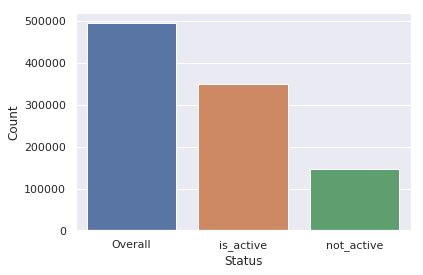

In [16]:
overall, is_active, not_active = len(master_df),len(master_df.loc[(master_df['is_active'] == 1)]),len(master_df.loc[(master_df['is_active'] == 0)])
data = {'Status':['Overall', 'is_active', 'not_active'], 'Count':[overall, is_active, not_active]}
df = pd.DataFrame(data)
sns.barplot(x='Status',y='Count',data=df, ci='None')

#### Commentray on the graph

We see that ~70% of the recorded events have a "1" in their "is_active" field, which, according to our defintion is considered to be an indication of virality.

* The overall recorded unique events are: 494,690
* The events where the activity is recorded as 1: 349,110 or 70.5%
* The events where the activity is recorded as 0: 145,580 or 29.5%

We will be working with the events that have a "1" in their "is_active" field for the rest of the analysis provided in **Part 1 - Question 1**.

#### 2. We start by plotting the categories with the highest contribution

By looking at the contribution of each app category, then choosing the categories that are highest in contribution, this will help us in reducing the number of app categories that we are trying to study the **Virality** for, as well as have a direct effect on the speed of the algorithms that we'll be using in this section.

In order to achieve that, we start by rank ordering the categories with the highest count of events (highest to lowest), then we plot the # of **Categories** on the **x-axis** and the **Contribution** (Count of events by category / Total count of events) on the **y-axis**. This will ultimately help us in knowing which app categories to work with. 

The big picture here is that the contribution of the different app categories to the number of generated events should follow (one could assume) a **Pareto Distribution** where the 80/20 rule explains the situation in hand (20% of the distribution make up 80% of the effect). 

In [17]:
# parsing out Category as a separate data frame
category = master_df.loc[(master_df['is_active'] == 1)]
category = category[['category','event_id']]
category = category.groupby(['category']).count().sort_values(by=['event_id'],ascending=False)
category = category.reset_index().rename(columns={'event_id':'count'})
category.head()

,category,count
0,Property Industry 1.0,178167
1,Industry tag,79626
2,Finance,30221
3,Debit and credit,24632
4,Internet Banking,8359


The first 10 categories are the highest in contribution which is equal to 0.955
The list of apps with the highest contribution are ['Property Industry 1.0', 'Industry tag', 'Finance', 'Debit and credit', 'Internet Banking', 'Wealth Management', 'pictures photography', 'health', 'video', 'Sports News']


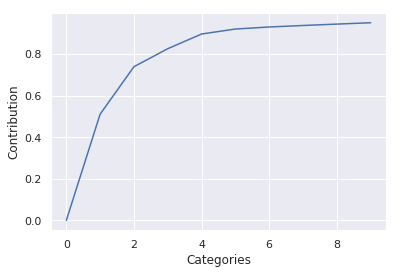

In [18]:
# plotting the categories with their contribution
Contribution=[]
Categories=[]
t = category.sum(axis=0)
for i in range(1000):
    x = category[:i].sum(axis=0)
    n = x['count'] / t['count']
    if n >= 0.95:
        break
    Categories.append(i)
    Contribution.append(n)
plot = pd.DataFrame(list(zip(Categories, Contribution)), 
               columns =['Categories', 'Contribution']) 
sns.lineplot(x='Categories',y='Contribution',data=plot)

print('The first',i,'categories are the highest in contribution which is equal to',round(n,3))
print('The list of apps with the highest contribution are',list(category['category'].head(i)))
category_list = list(category['category'].head(i))

We see that only 3 categories make up around 80% of the contribution, those 3 categories comprise just 2% of the total available list of categories. Taking the ~95% contribution as our cut off will result in selecting 10 categories, which by and large, add up to a more comprehensive list. They are **(Property Industry 1.0, Industry tag, Finance, Debit and credit, Internet Banking, Wealth Management, pictures photography, health, video, Sports News)**. 



#### 3. Comparing the virality for the events that have "1" in their "is_active" field

To do that we will plot the count of events in each app category using a bar chart as shown below.

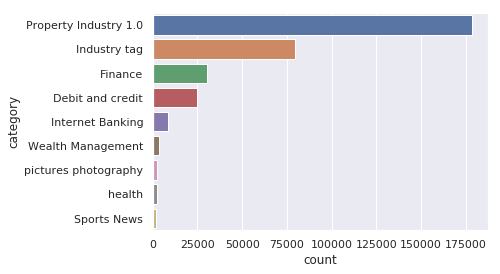

In [19]:
barplot_df = category.loc[(category['category'] == 'Property Industry 1.0') | 
                      (category['category'] == 'Industry tag') | 
                     (category['category'] == 'Finance') |
                     (category['category'] == 'Debit and credit') |
                     (category['category'] == 'Internet Banking') |
                     (category['category'] == 'Wealth Management') |
                     (category['category'] == 'pictures photography') |
                     (category['category'] == 'health') |
                     (category['category'] == 'videos') |
                     (category['category'] == 'Sports News')]
sns.barplot(y='category',x='count',data=barplot_df,ci='None')

In the following, we will be looking at the geolocations of the events in the DataFrame and checking where the concentration of events are and if different app categories are concentrated in certain areas or dispersed over the map of China.

#### 4. Plotting China's map with the recorded events

In the following, a map will detail the locations of the recorded events, the different colors correspond to the list of app categories that were selected (~95% contribution). Moreover, multiple random samples of points were taken from each category and plotted on the map (5000 events from each category), this is done due to how large the dataset is and the computational requirements needed to render a map with all the events in the csv file.

In [20]:
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'black', 'darkblue', 'green']
latitude = 35.8617
longitude = 104.1954
counter = -1

# create map of China using latitude and longitude values
map_China = folium.Map(location=[latitude, longitude], zoom_start=3,prefer_canvas=True,width='75%',height='75%')
    
# add markers to map
for i in category_list:
    
    counter += 1
    df = master_df.loc[(master_df['category'] == i) | (master_df['is_active'] == 1)]
    df = df.sample(n=5000 , replace=False) 
    
    for lat, lng, label in zip(df['latitude'], df['longitude'], df['category']):
        folium.CircleMarker(
        [lat, lng],
        radius=4,
        color = colors[counter],
        parse_html=False).add_to(map_China)        
map_China

If the map is not shown, please click on this link to view a screenshot of the output:

https://github.com/abzakh/git_STV/blob/master/Screen%20Shot%202020-09-18%20at%208.14.38%20PM.png

#### Commentary on the map and the plotted events

To put things into perspective, we need to look at the Chinese population density on the map (https://www.beijingcitylab.com/projects-1/4-population-china/ - it can be found on this link), the match between the two maps is almost identical. The pattern seen here follows exactly the population distribution on the map in the link. This observation, while might seem far from the topic of **virality**, is actually relevant, in the sense that activity on those applications follows what is normal (i.e. where the population is concentrated). In that respect, we don't see any anomalies of apps being used in geographies with low population density.

Another angle for investigating the plotted events, is how (dispersed vs. concentrated) they are on the map. The only app category that seems to be marginally different from the others is the **sports news - green cirlcles** category, where we see a high concentration in two areas (south and south east of the country). As for the other app categories we see a somewhat uniform scatter over the map of China.

### Part 1 - Question 2: Are you able to predict growth for an app based on virality?

In order to answer this question, it is wise to look at the relationship between virality and growth first. One could argue that both are just flip images for the same coin. This is true for most products/services, with one factor preceeding the other (i.e. either virality leading and growth lagging or vice versa). Given the dataset, we were able to identify one of the fields as an indicator of virality. Whether the ***Virality*** that we have is (leading or lagging), predicting it should be an indicator of growth. This will be the basic assumption behind predicting ***Virality*** using the following algorithms.

Predicting **Virality** will take the form of estimating whether a certain app category takes a value of (1 or 0) / (active or inactive), in other words, we have a classification problem that will be addressed by using two models (Classifaction Models), they are:

* K Nearest Neighbors (KNN)
* Logistic Regression

Following the work on the models, we will be evaluating them with three methods, and selecting the model with the best scores:

* Jaccard Similarity Score
* F1 Score
* LogLoss

#### 1. We start by parsing out the dataset of app categoris with the highest contribution for the analysis

The feature dataset will include the app categories that are highest in contribution (to the recorded events), which is defined in Part 1 - Questoin 1.  

In [21]:
analysis_df = master_df.loc[(master_df['category'] == 'Property Industry 1.0') | 
                      (master_df['category'] == 'Industry tag') | 
                     (master_df['category'] == 'Finance') |
                     (master_df['category'] == 'Debit and credit') |
                     (master_df['category'] == 'Internet Banking') |
                     (master_df['category'] == 'Wealth Management') |
                     (master_df['category'] == 'pictures photography') |
                     (master_df['category'] == 'health') |
                     (master_df['category'] == 'video') |
                     (master_df['category'] == 'Sports News')]
analysis_df.head()

,event_id,device_id,timestamp,longitude,latitude,app_id,is_installed,is_active,label_id,category,gender,age,group
0,127,-2941431931967728894,2016-05-01 00:16:16,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
5,58586,-2941431931967728894,2016-05-02 21:02:05,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
10,84463,-2941431931967728894,2016-05-07 07:04:21,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
15,138120,-2941431931967728894,2016-05-01 18:56:15,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31
20,242684,-2941431931967728894,2016-05-02 05:23:44,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31


The  **timestamp** field will be changed into a day_of_week (0-Sunday, 1-Monday, 3-Tuesday,...etc) and consider it as a predictor variable for **Virality**

In [22]:
analysis_df['timestamp'] = analysis_df['timestamp'].astype('datetime64[ns]')
analysis_df['dayofweek'] = analysis_df['timestamp'].dt.dayofweek
analysis_df = analysis_df.drop(['timestamp'],axis=1)
analysis_df.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


,event_id,device_id,longitude,latitude,app_id,is_installed,is_active,label_id,category,gender,age,group,dayofweek
0,127,-2941431931967728894,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31,6
5,58586,-2941431931967728894,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31,0
10,84463,-2941431931967728894,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31,5
15,138120,-2941431931967728894,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31,6
20,242684,-2941431931967728894,0.0,0.0,5927333115845830913,1,1,549,Property Industry 1.0,M,29,M29-31,0


#### 2. Predicting virality using KNN (K-Nearest Neighbors) 

The process starts by preparing the dataframes that are needed for the predictor & target variables.

The feature dataset is parsed out at first (i.e. the dataset for the predictor variables), then the categorical variables (in the category field) are changed into numerical ones so that they are compatible with how the algorithm works (The algorithm only takes numerical values).

In [29]:
feature_KNN = analysis_df[['is_installed','category','gender','age','dayofweek']]
feature_KNN['gender'].replace(to_replace=['M','F'], value=[0,1],inplace=True)
feature_KNN['category'].replace(to_replace=['Property Industry 1.0', 'Industry tag', 'Finance', 'Debit and credit', 'Internet Banking', 
                                        'Wealth Management', 'pictures photography', 'health', 
                                        'video', 'Sports News'], value=[0,1,2,3,4,5,6,7,8,9],inplace=True)
feature_KNN.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/generic.py:6586: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


,is_installed,category,gender,age,dayofweek
0,1,0,0,29,6
5,1,0,0,29,0
10,1,0,0,29,5
15,1,0,0,29,6
20,1,0,0,29,0


Parsing out the predictor variable and changing the numerical variables into categorical ones so that they are compatible with how the model work. 

In [24]:
y_KNN = analysis_df
y_KNN['is_active'].replace(to_replace=[1,0], value=['Active','Inactive'],inplace=True)
y_KNN = y_KNN['is_active']

Normalizing the dataset and splitting it into Train/Test datasets

In [27]:
# Preparing the PREDICTOR variables and the TARGET variable 
x_KNN = feature_KNN
y_KNN

# Normalize the dataset
x_KNN = preprocessing.StandardScaler().fit(x_KNN).transform(x_KNN)

# Splitting the data sets into Train/Test
from sklearn.model_selection import train_test_split
X_train_KNN, X_test_KNN, y_train_KNN, y_test_KNN = train_test_split(x_KNN, y_KNN, test_size=0.2, random_state=3)
print ('Train set:', X_train_KNN.shape,  y_train_KNN.shape)
print ('Test set:', X_test_KNN.shape,  y_test_KNN.shape)

Train set: (374084, 5) (374084,)
Test set: (93521, 5) (93521,)


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype int64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:6: DataConversionWarning: Data with input dtype int64 were all converted to float64 by StandardScaler.


In the following, we will try to figure out the best K (Number of Neighbors) for the model, by plotting the accuracy of the model with K. The plot will enable us to select the K that will yield the highest accuracy.

[0.65429155 0.60001497 0.68229595 0.66109216 0.71256723 0.69849553
 0.72115354 0.70873921 0.72517403 0.71971001 0.73253066 0.72933352
 0.73370687 0.73397419]


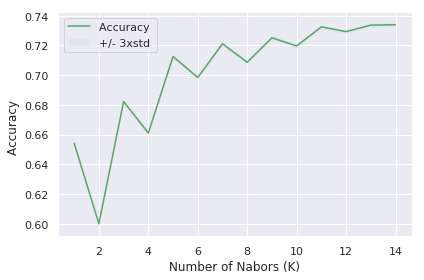

In [64]:
# Importing KNN library
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

# Figuring out the best K for the model
Ks = 15
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train_KNN,y_train_KNN)
    yhat_KNN=neigh.predict(X_test_KNN)
    mean_acc[n-1] = metrics.accuracy_score(y_test_KNN, yhat_KNN)
    
    std_acc[n-1]=np.std(yhat_KNN==y_test_KNN)/np.sqrt(yhat_KNN.shape[0])

print(mean_acc)

# Plotting Accuracy vs. K
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.05)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

Looking at the plot above, k=14 is selected, as it is outputting the highest accuracy for the model. In the following, the model is trained using the train dataset prior to testing it on the (test dataset). After that, the accuracy score will be calculated which measures the degree of the match between the two subsets (e.g. a test dataset vs. a predicted one) 

In [28]:
# Initilzing K and Train the Model (Train Set)
k = 14
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train_KNN,y_train_KNN)

# Prediction with the Model (Test Set)
yhat_KNN = neigh.predict(X_test_KNN)

# Testing Model Accuracy
from sklearn import metrics
print("Train Accuracy is", metrics.accuracy_score(y_train_KNN,neigh.predict(X_train_KNN)))
print("Test Accuracy is", metrics.accuracy_score(y_test_KNN,yhat_KNN))

Train Accuracy is 0.7397162134707713
Test Accuracy is 0.7376525058543001


The model is outputting almost equal accuracy scores for both:

* **Train Accuracy = 73.9%**: The accuracy of the model on examples it was constructed on (Train dataset).
* **Test Accuracy = 73.7%**: The accuracy of the model on examples it hasn't seen (Test dataset)

Looking at the **Train accuracy**, we see that its score is not overly high, this indicates that there is no overfitting, and that the model is fit for generalization. Moreover the **Test Accuracy** scroe is relatively high to produce accurate results given the scarcity of the provided data (predictor variables are mostly categorical variables).

#### 3. Predicting virality using Logistic Regression

The same process that was done in modeling KNN is replicated here, the dataframes that are needed for the predictor & target variables are prepared before modeling.

Here, the same feature dataset that was parsed out at first in modeling KNN (i.e. the dataset for the predictor variables), will be used again given that it is already in the desired format.

In [30]:
feature_LR = feature_KNN
feature_LR.head()

,is_installed,category,gender,age,dayofweek
0,1,0,0,29,6
5,1,0,0,29,0
10,1,0,0,29,5
15,1,0,0,29,6
20,1,0,0,29,0


The predictor variable is then parsed out and changed to a numerical variable (The Logistic Regression model only takes numerical variables).

In [45]:
y_LR = analysis_df
y_LR['is_active'].replace(to_replace=['Active','Inactive'], value=[1,0],inplace=True)
y_LR = y_LR[['is_active']]

Normalizing the dataset and splitting it into Train/Test datasets

In [47]:
# Preparing the PREDICTOR variables and the TARGET variable + transforming them into numpy arrays for maximum compatability with the model
x_LR = feature_LR.values
y_LR = y_LR.values

# Normalize the dataset
x_LR = preprocessing.StandardScaler().fit(x_LR).transform(x_LR)

# Splitting the data sets into Train/Test
from sklearn.model_selection import train_test_split
X_train_LR, X_test_LR, y_train_LR, y_test_LR = train_test_split(x_LR, y_LR, test_size=0.2, random_state=3)
print ('Train set:', X_train_LR.shape,  y_train_LR.shape)
print ('Test set:', X_test_LR.shape,  y_test_LR.shape)

Train set: (374084, 5) (374084, 1)
Test set: (93521, 5) (93521, 1)


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


The same procedure that was followed earlier with the KNN model, will be followed here. First the model is run on the train dataset, after which, the test data set is used for prediction, finally, (train/test) accuracy is measured.

In [48]:
# Import LR library and setting up the algorithm
from sklearn.linear_model import LogisticRegression
virality_LR = LogisticRegression(C=0.01, solver='saga')

# Training the Model
virality_LR.fit(X_train_LR,y_train_LR)

# Predicting with Model
yhat_LR = virality_LR.predict(X_test_LR)
yhat_LR

# Testing Model Accuracy
print("Train Accuracy is", metrics.accuracy_score(y_train_LR,virality_LR.predict(X_train_LR)))
print("Test Accuracy is", metrics.accuracy_score(y_test_LR,yhat_LR))

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:761: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Train Accuracy is 0.712853262903519
Test Accuracy is 0.7123319896066124


Again the model here is giving us almost equal accuracy for both:

* **Train Accuracy = 71.28%**
* **Test Accuracy = 71.23%**

In terms of (train/test) accuracy score, the commentary here is similar to the one provided above. We see a (initial) slight advantage for the KNN (K-Nearest Neighbor) over the LR (Logistic Regression) in terms of both (train/test) accuracy scores.

#### 4. Evaluating the models that were used in the prediction exercise

As mentioned above, the performance of each model will be assessed based on three evaluation methods, they are:

* **Jaccard Similarity Score**: The Jaccard similarity index (sometimes called the Jaccard similarity coefficient) compares members for two sets to see which members are shared and which are distinct. It's a measure of similarity for the two sets of data, with a range from 0% to 100%. The higher the percentage, the more similar the two populations (i.e. the higher the score, the higher is the match between what is predicted and what is true)


* **f1_score**: F1 Score is the weighted average of Precision and Recall. Where precision is defined as (the number of True Positives divided by the number of True Positives and False Positives) and recall as (the number of True Positives divided by the number of True Positives and the number of False Negatives). Thre F1 score conveys the balance between the precision and the recall.


* **log_loss**: It is a measure of uncertainty, so a low Log Loss means a low uncertainty in the output of model. 

Prior to evaluating the models, some of the dataframes will be arranged in the format that is compatible with the evaluation functions.

* **For the Jaccard Similarity Score**

In [34]:
x_JMS = feature_KNN.values
y_JMS = analysis_df[['is_active']].values
x_JMS = preprocessing.StandardScaler().fit(x_JMS).transform(x_JMS)

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype int64 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


* **For the f1 Score**

In [69]:
y_f1score = neigh.predict(x_JMS)
y_f1score = np.where(y_f1score == 'Active',1,np.where(y_f1score == 'Inactive',0,''))
y_f1score = y_f1score.astype('int')

Below is the evaluation for both of the models that were used in predicting virality.

In [75]:
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss

Report = {'Algorithm':['KNN','LogisticRegression'],
          'Jaccard':[jaccard_similarity_score(y_JMS,neigh.predict(x_JMS)),jaccard_similarity_score(y_LR,virality_LR.predict(x_JMS))],
          'F1-score':[f1_score(y_LR,y_f1score),f1_score(y_LR,virality_LR.predict(x_JMS))],
          'LogLoss':['NA',log_loss(y_LR,virality_LR.predict_proba(x_LR))]}
Report = pd.DataFrame(Report)
Report.set_index('Algorithm')

,Jaccard,F1-score,LogLoss
Algorithm,,,
KNN,0.739303,0.834564,NA
LogisticRegression,0.712749,0.832287,0.596553


#### Commentary on the results of the evaluation methods

Looking at the results for the three evaluation methods (**Jaccard** + **F1 Score** + **Log Loss**). We can spot that the **KNN Model** is superior to the **LogisticRegression** model. Moreover, the *LogLoss* for the **LogisticRegression** model is quite high (~60% uncertainity) which reflects a low confidence in the output of that model.

### Part 2  - Provide the business insights you find most compelling in this dataset. These can be for a fund, for an app owner, or any other party you choose. We expect you to analyze the dataset, extract some key insights, and visually present those to a business leader in the organization

A Partial part of this ask was answered in **Part 1 - Question 1**, where the apps with the highest contribution to the number of recorded events were identified using the concept behind the **Pareto Distribution** (Although, a more extreme example to the 80/20 rule was found to be the case). 

Given that the app categories with the highest contribution are identified, a simple count function for the **"is_active"** field, grouped by those high in contribution, would reveal the ones that are popular/viral the most. This was presented in the Part 1, it is repeated here for its relevance to the context.

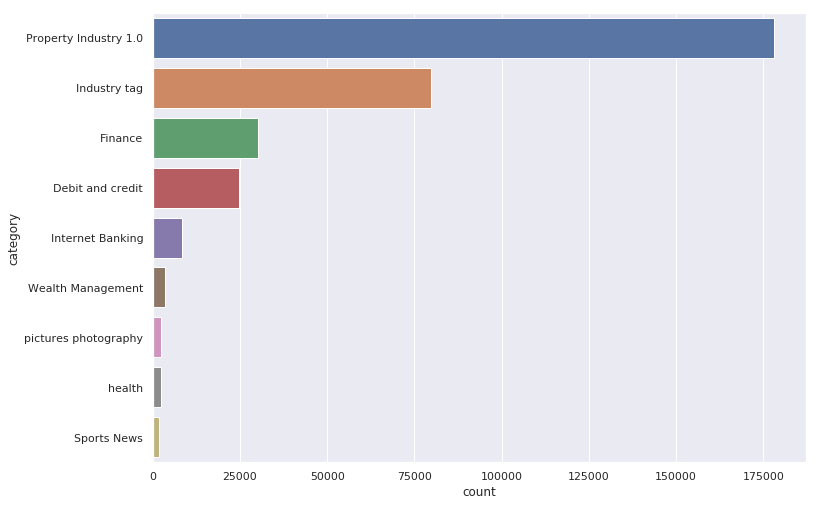

In [62]:
sns.barplot(y='category',x='count',data=barplot_df,ci='None')

To get a deeper understanding of the activity on each app category, they will be broken down further by gender and day of week (given that those two data points are the only ones that would create enough distinction in the provided dataset for an insight to be formulated).

* **First, we start with the app categories with the highest contribution and gender mix**

In [55]:
viral_df = analysis_df.groupby(["category","gender"])["is_active"].sum()
viral_df = viral_df.to_frame()
viral_df = viral_df.sort_values(by=['is_active'],ascending=False).reset_index()
viral_df

,category,gender,is_active
0,Property Industry 1.0,M,114653
1,Property Industry 1.0,F,63514
2,Industry tag,M,56495
3,Industry tag,F,23131
4,Finance,M,22823
5,Debit and credit,M,21429
6,Finance,F,7398
7,Internet Banking,M,5625
8,Debit and credit,F,3203
9,Internet Banking,F,2734


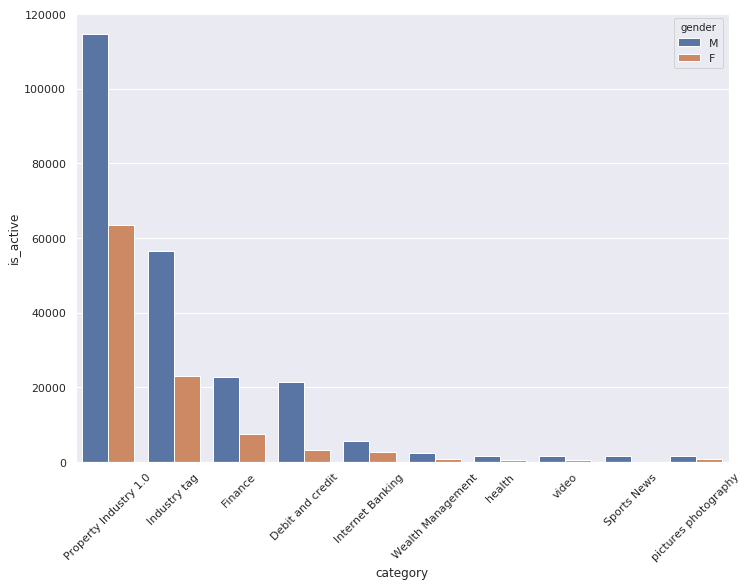

In [61]:
ax = sns.barplot(x='category',y='is_active',hue='gender',data=viral_df)
for item in ax.get_xticklabels():
    item.set_rotation(45)

* **Second, we check the days that are highest in apps usage (is_active = 1)**

In [79]:
viral_df2_1 = analysis_df.groupby(["dayofweek"])["is_active"].sum()
viral_df2_1 = viral_df2_1.to_frame()
viral_df2_1 = viral_df2_1.sort_values(by=['is_active'],ascending=False).reset_index()
viral_df2_1['dayofweek'].replace(to_replace=[0,1,2,3,4,5,6], value=['Monday','Tuesday','Wednesday','Thursday','Friday',
                                                                  'Saturday','Sunday'],inplace=True)
viral_df2_1

,dayofweek,is_active
0,Friday,49984
1,Tuesday,49447
2,Thursday,48820
3,Wednesday,47680
4,Saturday,46922
5,Monday,45292
6,Sunday,45140


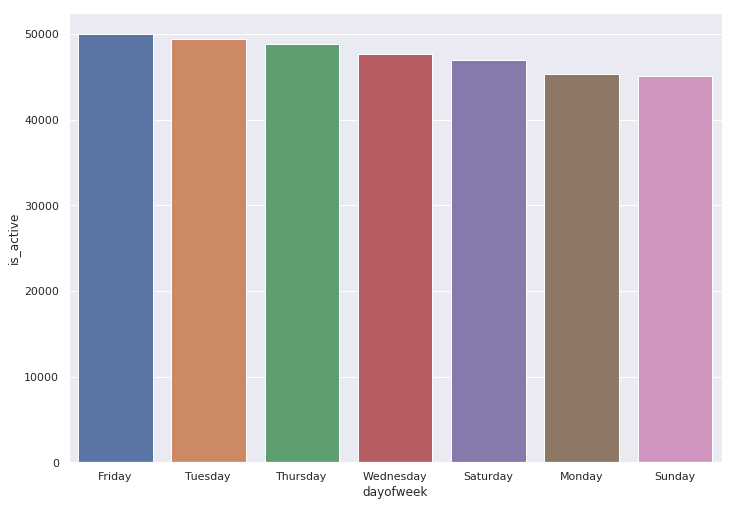

In [75]:
ax = sns.barplot(x='dayofweek',y='is_active',data=viral_df2_1)

In [76]:
viral_df2_2 = analysis_df.groupby(["category","dayofweek"])["is_active"].sum()
viral_df2_2 = viral_df2_2.to_frame()
viral_df2_2 = viral_df2_2.sort_values(by=['is_active'],ascending=False).reset_index()
viral_df2_2['dayofweek'].replace(to_replace=[0,1,2,3,4,5,6], value=['Monday','Tuesday','Wednesday','Thursday','Friday',
                                                                  'Saturday','Sunday'],inplace=True)
viral_df2

,category,dayofweek,is_active
0,Property Industry 1.0,Tuesday,26544
1,Property Industry 1.0,Friday,26446
2,Property Industry 1.0,Saturday,25883
3,Property Industry 1.0,Thursday,25843
4,Property Industry 1.0,Wednesday,25482
5,Property Industry 1.0,Monday,24236
6,Property Industry 1.0,Sunday,23733
7,Industry tag,Friday,12103
8,Industry tag,Tuesday,11587
9,Industry tag,Thursday,11523


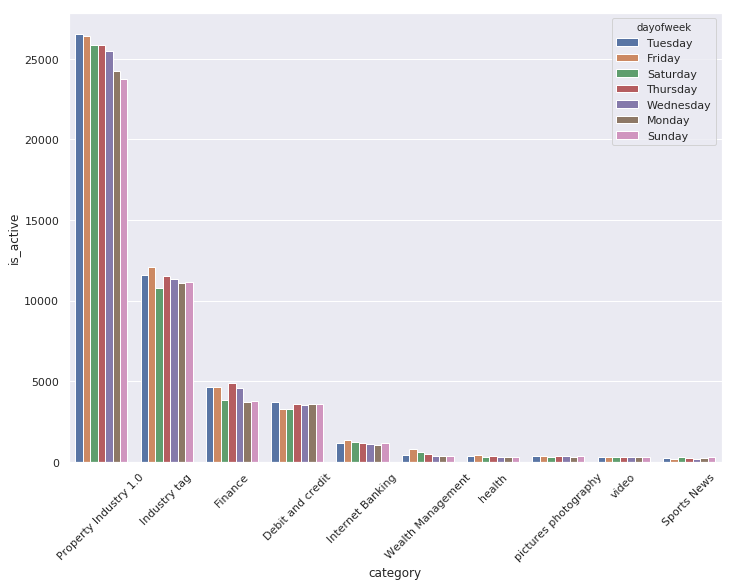

In [77]:
ax = sns.barplot(x='category',y='is_active',hue='dayofweek',data=viral_df2_2)
for item in ax.get_xticklabels():
    item.set_rotation(45)

We check if there is a significant difference between the proportion of Females to Males responsible for the recorded events across the days of the week

In [39]:
gender_day = analysis_df[["dayofweek","gender"]]
gender_day = pd.concat([gender_day,pd.get_dummies(gender_day['gender'])], axis=1)
gender_day = gender_day.groupby(["dayofweek"])["F",'M'].sum().reset_index()
gender_day = pd.concat([gender_day,gender_day['F']+gender_day['M']], axis=1).rename(columns={0: "Total"})
gender_day = pd.concat([gender_day['dayofweek'],gender_day['F']/gender_day['Total'],
                        gender_day['M']/gender_day['Total']], axis=1).rename(columns={0: "F-Ratio",1:"M-Ratio"})
gender_day['dayofweek'].replace(to_replace=[0,1,2,3,4,5,6], value=['Monday','Tuesday','Wednesday','Thursday','Friday',
                                                                  'Saturday','Sunday'],inplace=True)
gender_day

,dayofweek,F-Ratio,M-Ratio
0,Monday,0.293365,0.706635
1,Tuesday,0.294931,0.705069
2,Wednesday,0.295004,0.704996
3,Thursday,0.303672,0.696328
4,Friday,0.304635,0.695365
5,Saturday,0.303642,0.696358
6,Sunday,0.288492,0.711508


In order to check if there is a significant difference between the proportions, we will perform a hypothesis test on whether the day with the lowest Female(Recorded Events)/Total proportion **(Sunday)** is significantly different from the second lowest day **(Monday)**.

* **Population**: Males and Females in the dataset (467,605)
* **parameter of interest**: p (proportion)
* **Null Hypothesis**: p = 0.288492
* **Alternative Hypothesis**: p > 0.288492

Is p = 0.288492 significantly different from p = 0.304635 ?

In [42]:
import statsmodels.api as sm
n = 467605
pnull = 0.288492
p_alternative = 0.304635
sm.stats.proportions_ztest(p_alternative * n, n, pnull)

(23.984325355212142, 4.052981115833903e-127)

#### Commentary on the performed hypothesis test

The p-value obtained from the output of the function above is 4.052e-127 << 0.05 (taking the confidence interval to be 95%), this means that we have a strong evidence against the null hypothesis and that the proportion of F/M on the (lowest day) is significantly different from the one in the (second lowest day), thus, this can be generalized to the rest of the weekdays where the gap is bigger. This significant difference is the result of the size of the dataset (i.e. the rate of decrease/increase in males'/females' usage from day to day is creating a statistical significance reflected in the p-value above). This is an important observation because the F/M ratio increases on a daily basis (if we start tracking the movement from Sunday onwards) and investigating the increase of females participation or males non-engagement will be worth the effort to know exactly what are the drivers for this change.

* **Finally, we check the apps usage for (gender-age group)**

In [116]:
viral_df3 = analysis_df.groupby(["group"])["is_active"].sum()
viral_df3 = viral_df3.to_frame()
viral_df3 = viral_df3.sort_values(by=['is_active'],ascending=False).reset_index()
viral_df3

,group,is_active
0,M32-38,55684
1,M39+,54788
2,M23-26,38617
3,M29-31,36861
4,F33-42,25791
5,M27-28,23310
6,M22-,20999
7,F43+,18046
8,F29-32,17143
9,F24-26,15523


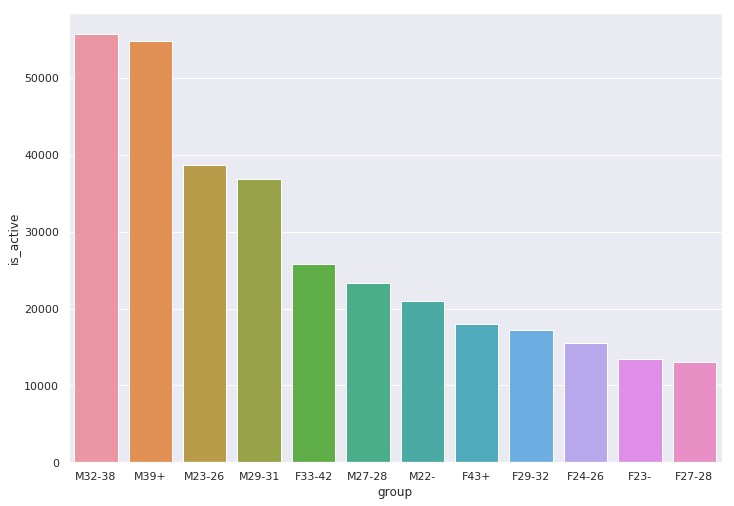

In [117]:
ax = sns.barplot(x='group',y='is_active',data=viral_df3)

Given the generated charts, we can breakdown the insights into two main categories:

* **The apps that are highest in use - Insight for a Fund:**

Given the provided dataset, the apps that are dominant in terms of recorded events are (Property Industry , Industry Tag , Finance), where they contributed to more than 80% of those events. This is considered to be an initial understanding of the categories that are highest in use and where a ***Fund*** would likely allocate money for investment. 

That is not to say that a fund should be investing in those app categories only. It is just an initial overview of what could be high growth sectors and where a good bet might be. Following the identification of the high growth sectors, one should be investigating the individual apps in those categories to zero-in on the best opportunity for investing. In light of the provided dataset, this piece of information is not available.

* **Gender mix & Age Groups / Days with the highest apps usage  - Insight for an App Owner:**


1. In terms of gender mix and age group, we see that the vast majority of events are coming from, by and large, male users. This is an important observation when coupled with the age groups, as it gives an app owner the initial understanding of the segments in the marekt, as well as how to target those different age/gender groups based on the service that is being offered to them and the narrative used in targeting them.


2. In terms of the days with the highest app usage, we see an upward trending trajectory Sunday onwards. This is also an important observation to account for the increase in demand/traffic on the apps (depends on the app type and the services/products it provides), especially on Fridays/Tuesdays/Thursdays. Accounting for this increase in demand/traffic on the apps might come in the form of increasing the system's capacity to take on more demand in the days that are high in surge.